## Set up

In [1]:
import sys
sys.path.append('./scripts/')
import os
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import matplotlib.axes as axes
import seaborn as sns
import math
import copy
import numpy as np
sns.set_style("darkgrid")
from PIL import Image
import random # random seed to reproduce MDS and t-SNE plots

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn import cluster # k-Means clustering
from sklearn.cluster import KMeans
from sklearn import manifold # MDS and t-SNE
from sklearn.metrics import silhouette_score # silhouette width for clustering
from sklearn import preprocessing # scaling attributes
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics.pairwise import pairwise_distances
import hdbscan
import umap

import torch
import torchvision

from lucent.optvis import render, param, transform, objectives

import imp
import my_datasets
import utilities 
imp.reload(my_datasets) 
imp.reload(utilities) 

plt.rcParams["figure.figsize"] = (3,3)
random.seed(2023)

/tmp/ipykernel_3131/2960316723.py:34: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  import imp


In [2]:
# dataset='ilsvrc12fine'
dataset='ilsvrc12'
paths, count, y, idx_to_labels = my_datasets.get_dataset(dataset)

print(count, len(paths))

10000 10000


In [3]:
# For ilsvrc12fine dataset, paths are mapped differently
if dataset=='ilsvrc12fine':
    idxs=np.arange(0, 1281167, 10) # 1281167
    classes=np.unique(y[idxs])
    ppaths=[paths[i] for i in idxs]
    paths=ppaths

In [4]:
layer='Mixed_7b.cat_2'
SAVEFOLD0=f'../outputs/{dataset}'
SAVEFOLD=f"{SAVEFOLD0}/{layer}/"

In [5]:
#gradients_wrt_conv_layer=np.load(f"{SAVEFOLD}/gradients_wrt_conv_layer.npy")
predictions=np.load(f"{SAVEFOLD}/predictions.npy", mmap_mode = 'r')
conv_maps=np.load(f"{SAVEFOLD}/conv_maps.npy", mmap_mode = 'r')

# pvh=np.load(f"{SAVEFOLD}/eigenvectors.npy",allow_pickle=True, mmap_mode = 'r')

Global average pooling of activations

In [6]:
conv_maps_avg = conv_maps.mean(3).mean(2)

In [7]:
activations = conv_maps_avg

## Utilities

## Settings

Some examples of neurons used in the paper:

1 underwater, scuba diving

5 peacock/police van

13 black background, clusters for performing

16 oval / lobster

22 toilet roll, brown dog face

35 sport/green apple

Some other interesting neurons:

18 snake, coral

25 writing sticking out and print

27 fluffy cream dog, book shelves

57 black dog, diagonal rod


In [8]:
# image collection params
direction = 35
top = 50

# clustering params
linkage='ward'
metric='euclidean'
distance_threshold = 12

kmeans_outlier_threshold = 15
min_ims_cluster = 5

# Step 1: Calculate top images and extract activations for selected neuron

#### If looking at neuron

In [9]:
top_ims = utilities.get_activations(activations_avg = activations, direction = direction).argsort()[-top:][::-1] 
top_activations = utilities.get_activations(activations_avg = activations, ims=top_ims)

## Step 2: Find number of clusters using agglomerative clustering

First, just look dendrogram

In [10]:
clusterer_0 = AgglomerativeClustering(n_clusters=None, distance_threshold=0, metric=metric,linkage=linkage )
clusterer_0.fit_predict(top_activations)

array([27, 47, 36, 26, 39, 40, 48, 41, 29, 46, 34, 43, 35, 25, 30, 37, 32,
       42, 31, 20, 23, 17, 19, 49, 45,  9, 12, 44, 33, 14, 15, 28, 22, 24,
       21, 11, 13, 38, 10, 16,  4, 18,  7,  8,  3,  1,  6,  5,  2,  0])

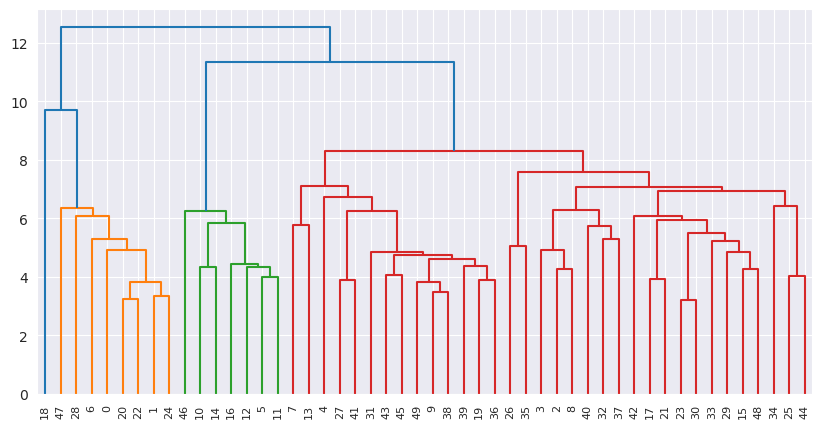

In [11]:
linkage_res = utilities.plot_dendrogram(clusterer_0, truncate_mode="level") # , p=100 # 

In [12]:
# clusterer_0.distances_

Cluster with set distance threshold

In [13]:
clusterer = AgglomerativeClustering(n_clusters=None, distance_threshold=distance_threshold, metric=metric,linkage=linkage)
clusterer.fit_predict(top_activations)

array([1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
       1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0])

Visualise how hierarchial clustering clusters number of clusters selected

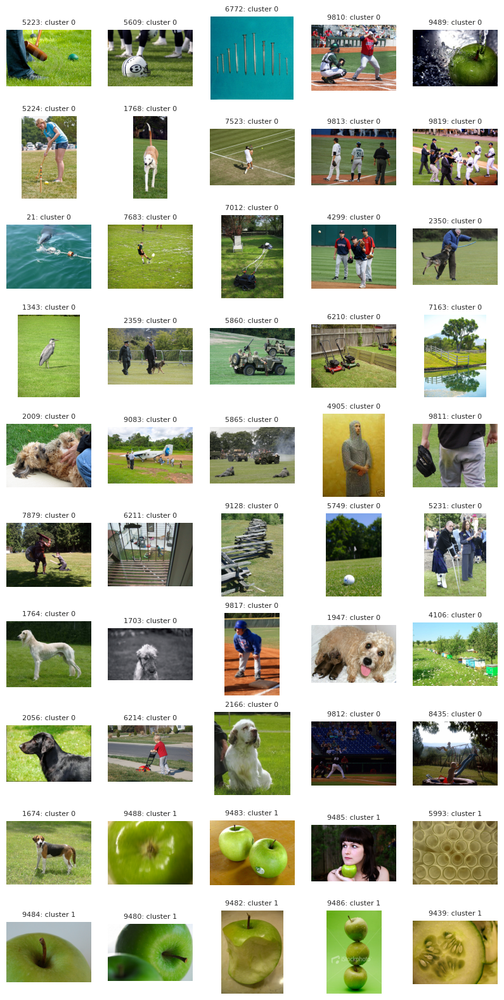

In [14]:
clu_labs = clusterer.labels_
# print(clu_labs)
clu_lab_order = sorted(range(len(clu_labs)), key=lambda k: clu_labs[k])

fig, ax = plt.subplots(math.ceil(len(top_ims)//5), 5, figsize = (10,20))
ax = ax.flatten()
for idx, im_id in enumerate(top_ims[clu_lab_order]):
    im = Image.open(paths[im_id])
    ax[idx].imshow(im)
    ax[idx].set_title(f"{im_id}: cluster {clu_labs[clu_lab_order][idx]}", size = 8)
    ax[idx].axis('off')

## Step 3: Run kmeans with number of clusters from step 2, remove outliers

Cluster with number of clusters selected with kmeans since need centroids to remove outliers

In [15]:
kmeans = KMeans(n_clusters=clusterer.n_clusters_, random_state=0, n_init=5, max_iter=1000).fit(top_activations)
# kmeans # "auto"

plot kmeans clusters before removing outliers

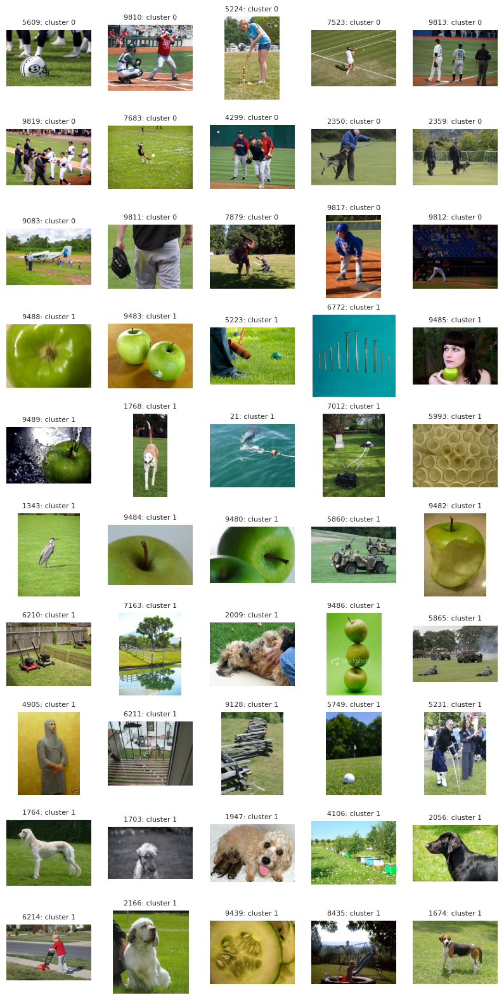

In [16]:
clu_labs = kmeans.labels_
# print(clu_labs)
clu_lab_order = sorted(range(len(clu_labs)), key=lambda k: clu_labs[k])

fig, ax = plt.subplots(math.ceil(len(top_ims)//5), 5, figsize = (10,20))
ax = ax.flatten()
for idx, im_id in enumerate(top_ims[clu_lab_order]):
    im = Image.open(paths[im_id])
    ax[idx].imshow(im)
    ax[idx].set_title(f"{im_id}: cluster {clu_labs[clu_lab_order][idx]}", size = 8)
    ax[idx].axis('off')

Visualise activations with UMAP

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


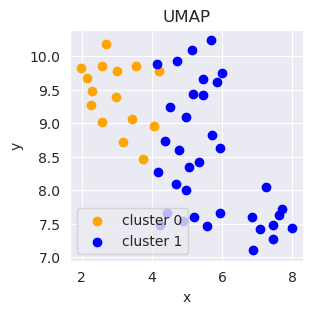

In [17]:
XY_UMAP = umap.UMAP(n_components=2).fit_transform(top_activations)
utilities.clustering_scatterplot(points=XY_UMAP, 
                       labels=clu_labs,
                       centers=None, 
                       title='UMAP')

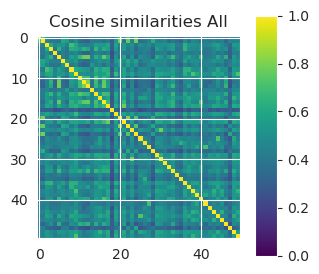

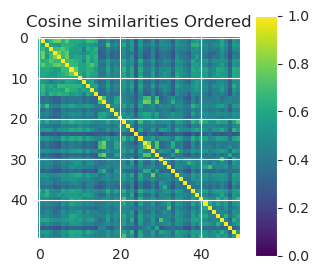

In [18]:
cosine_sim = utilities.plot_cosine_similarities(top_ims, min_sim=0, max_sim=1, maps = activations, label = 'All')
cosine_sim = utilities.plot_cosine_similarities(top_ims[clu_lab_order], min_sim=0, max_sim=1, maps = activations, label = 'Ordered')
# for cluster in np.unique(clu_labs): 
#     cosine_sim = utilities.plot_cosine_similarities(top_ims[clu_labs==cluster], min_sim=0, max_sim=1, maps = activations, label = f'Cluster {round(cluster)}')

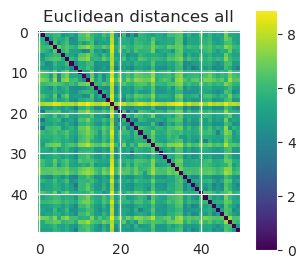

8.898201084139016
5.646881880754372


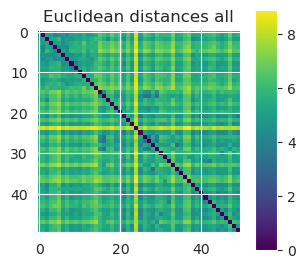

8.898201084139016
5.646881880754371


In [19]:
distance_matrix = utilities.plot_euclidan_distances(top_activations, label = 'all')
distance_matrix = utilities.plot_euclidan_distances(top_activations[clu_lab_order], label = 'all')
# for cluster in np.unique(clu_labs):
#     distance_matrix = utilities.plot_euclidan_distances(top_activations[clu_labs==cluster], label = f'cluster {round(cluster)}')

Need to remove outliers to purify clusters

Get squared distance to kmeans centroid of appropriate cluster - transform()

https://stackoverflow.com/questions/54240144/distance-between-nodes-and-the-centroid-in-a-kmeans-cluster

In [20]:
centroid_dist = kmeans.transform(top_activations)**2
nearest_centroid_dist = np.zeros(len(clu_labs))
nearest_centroid_dist = [centroid_dist[i,clu_labs[i]] for i in range(len(clu_labs))]
# nearest_centroid_dist
# kmeans.cluster_centers_

Calculate which images are outliers by removing observations far away from centroid

Rename outliers to now belong to cluster label '100'. They will now be ordered at the end. 

In [21]:
clu_labs_rm_outliers = np.empty(len(clu_labs))
clu_labs_rm_outliers[:] = 100
# clu_labs_rm_outliers
#clu_labs_rm_outliers = [centroid_dist[i,clu_labs[i]] for i in range(len(clu_labs))]
for i in range(len(clu_labs)):
    if nearest_centroid_dist[i] < kmeans_outlier_threshold:
        clu_labs_rm_outliers[i] = clu_labs[i]

visualise images remaining in clusters after removing outliers

In [22]:
# clu_labs_rm_outliers_order = sorted(range(len(clu_labs_rm_outliers)), key=lambda k: clu_labs_rm_outliers[k])

# fig, ax = plt.subplots(math.ceil(len(top_ims)//5), 5, figsize = (10,20))
# ax = ax.flatten()
# for idx, im_id in enumerate(top_ims[clu_labs_rm_outliers_order]):
#     im = Image.open(paths[im_id])
#     ax[idx].imshow(im)
#     ax[idx].set_title(f"{im_id}: cluster {clu_labs_rm_outliers[clu_labs_rm_outliers_order][idx]}", size = 8)
#     ax[idx].axis('off')

Remove clusters with less than treshold number of items

In [23]:
for cluster in range(clusterer.n_clusters_):
    count = sum(clu_labs_rm_outliers == cluster)
    # print(count)
    if count < min_ims_cluster: 
        # print(cluster)
        #clu_labs_rm_outliers[i] = clu_labs[i]
        clu_labs_rm_outliers[[clu_labs_rm_outliers[i] == cluster for i in range(len(clu_labs_rm_outliers))]] = 100

visualise images remaining in clusters after removing small clusters

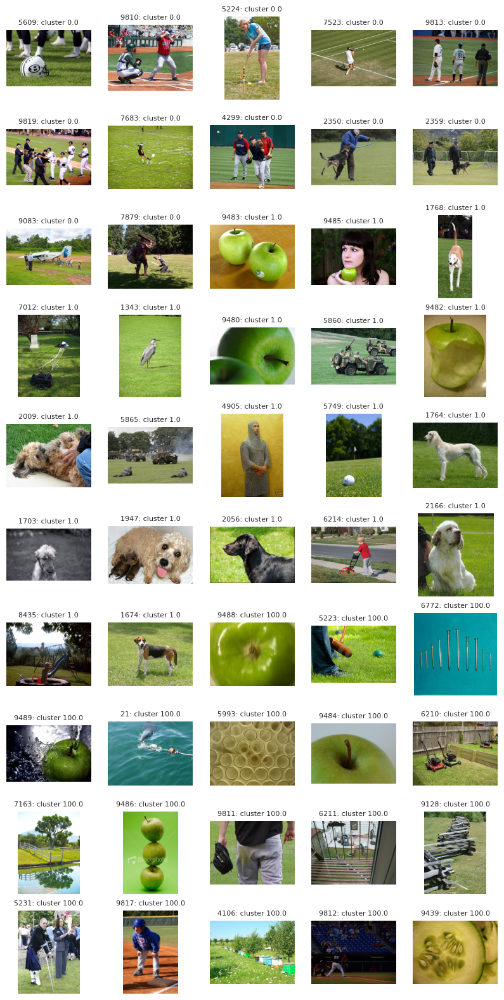

In [24]:
clu_labs_rm_outliers_order = sorted(range(len(clu_labs_rm_outliers)), key=lambda k: clu_labs_rm_outliers[k])

fig, ax = plt.subplots(math.ceil(len(top_ims)//5), 5, figsize = (10,20))
ax = ax.flatten()
for idx, im_id in enumerate(top_ims[clu_labs_rm_outliers_order]):
    im = Image.open(paths[im_id])
    ax[idx].imshow(im)
    ax[idx].set_title(f"{im_id}: cluster {clu_labs_rm_outliers[clu_labs_rm_outliers_order][idx]}", size = 8)
    ax[idx].axis('off')

Plot cosine similarities for all top images and clusters

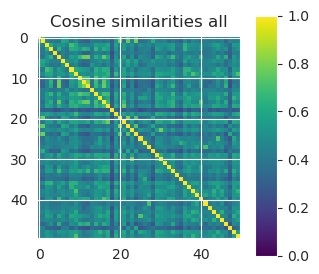

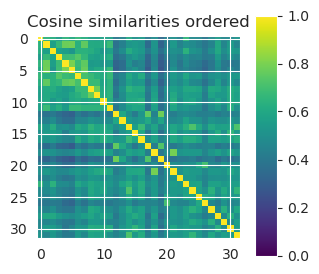

In [25]:
cosine_sim = utilities.plot_cosine_similarities(top_ims, min_sim=0, max_sim=1, maps = activations, label = 'all')
# cosine_sim = utilities.plot_cosine_similarities(top_ims[clu_labs_rm_outliers_order], min_sim=0, max_sim=1, maps = activations, label = 'ordered')
cosine_sim = utilities.plot_cosine_similarities(top_ims[clu_labs_rm_outliers_order][:top-list(clu_labs_rm_outliers).count(100)], min_sim=0, max_sim=1, maps = activations, label = 'ordered')
# for cluster in np.unique(clu_labs_rm_outliers):
#     if cluster == 100: 
#         pass
#     else:
#          cosine_sim = utilities.plot_cosine_similarities(top_ims[clu_labs_rm_outliers==cluster], min_sim=0, max_sim=1, maps = activations, label = f'cluster {round(cluster)}')

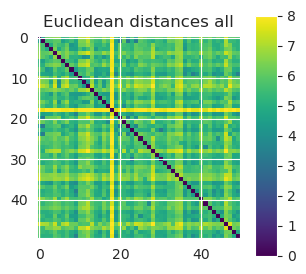

8.898201084139016
5.646881880754372


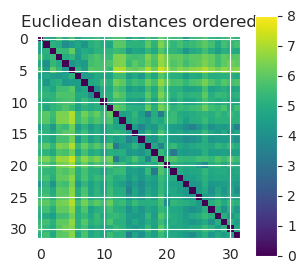

7.436441611092458
5.004242452703072


In [26]:
distance_matrix = utilities.plot_euclidan_distances(top_activations, 0, 8, label = 'all')
# distance_matrix = utilities.plot_euclidan_distances(top_activations[clu_labs_rm_outliers_order], 0, 8, label = 'ordered')
distance_matrix = utilities.plot_euclidan_distances(top_activations[clu_labs_rm_outliers_order][:top-list(clu_labs_rm_outliers).count(100)], 0, 8, label = 'ordered')
# for cluster in np.unique(clu_labs_rm_outliers):
#     if cluster == 100: 
#         pass
#     else:
#         distance_matrix = utilities.plot_euclidan_distances(top_activations[clu_labs_rm_outliers==cluster], label = f'cluster {round(cluster)}')

plot images: 

https://stackoverflow.com/questions/22566284/matplotlib-how-to-plot-images-instead-of-points

https://matplotlib.org/stable/gallery/text_labels_and_annotations/demo_annotation_box.html

add jitter to reduce overlap:

https://stackoverflow.com/questions/8671808/matplotlib-avoiding-overlapping-datapoints-in-a-scatter-dot-beeswarm-plot

Visualise embeddings of images remaining in clusters

[Text(0, 8.0, ''),
 Text(0, 9.0, ''),
 Text(0, 10.0, ''),
 Text(0, 11.0, ''),
 Text(0, 12.0, ''),
 Text(0, 13.0, ''),
 Text(0, 14.0, '')]

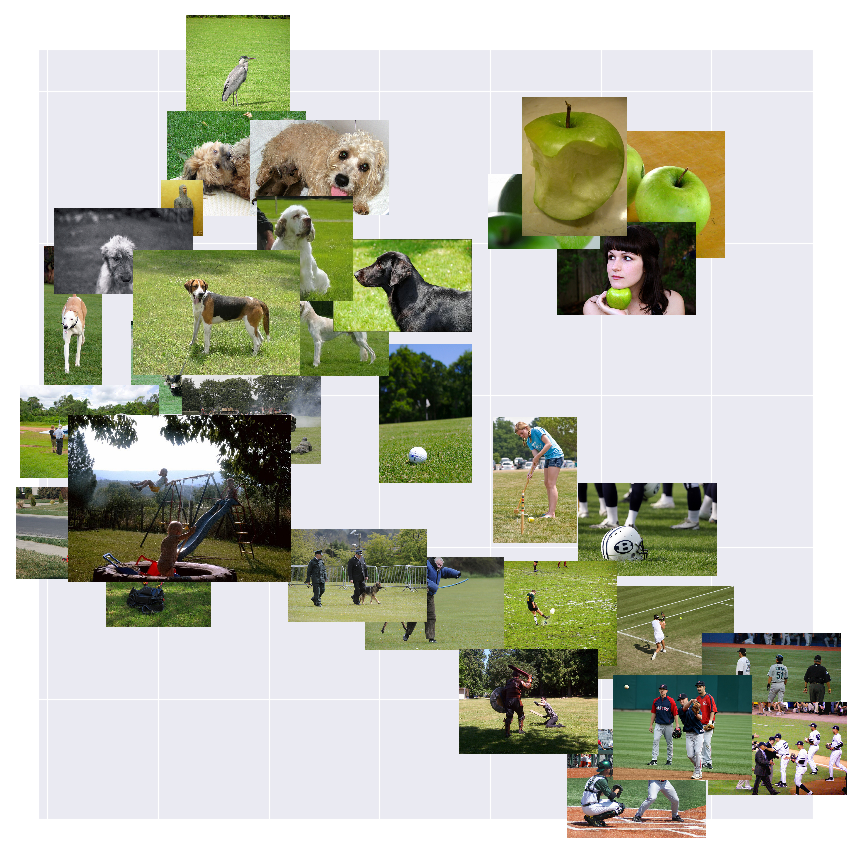

In [27]:
XY_UMAP = umap.UMAP(n_components=2).fit_transform(top_activations[clu_labs_rm_outliers != 100])
amount = 0#.05
fig, ax = plt.subplots(figsize = (10,10))
#ax.set_title("UMAP")
ax.scatter(XY_UMAP[:,0], XY_UMAP[:,1]) 

for x0, y0, path in zip(utilities.rand_jitter(XY_UMAP[:,0], amount), utilities.rand_jitter(XY_UMAP[:,1], amount), [paths[i] for i in top_ims[clu_labs_rm_outliers != 100]]):
    ab = AnnotationBbox(utilities.getImage(path), (x0, y0), frameon=False)
    ax.add_artist(ab)
ax.axes.xaxis.set_ticklabels([])
ax.axes.yaxis.set_ticklabels([])
#ax.axis('off') 

Plot normalised concepts (removed as same plot below..)

In [28]:
# for cluster in np.unique(clu_labs_rm_outliers):
#     if cluster == 100: 
#         pass
#     else:
#         plt.plot(top_activations[clu_labs_rm_outliers==cluster].mean(0)/np.linalg.norm(top_activations[clu_labs_rm_outliers==cluster].mean(0)))
#         plt.show()
#         print(f"Concept vector {round(cluster)}, direction {direction} activation: ", top_activations[clu_labs_rm_outliers==cluster].mean(0)[direction])
        

## Step 4: Calculate concept vectors

In [29]:
concept_vecs = []
for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        concept_vecs.append(top_activations[clu_labs_rm_outliers==cluster].mean(0)/np.linalg.norm(top_activations[clu_labs_rm_outliers==cluster].mean(0)))

In [30]:
for i in range(len(concept_vecs)): 
    # print("cosine similarity: ", np.dot(concept_vecs[i], 
    concepts_dot = np.empty([len(concept_vecs),len(concept_vecs)])
    concepts_sim = np.empty([len(concept_vecs),len(concept_vecs)])
    for i in range(len(concept_vecs)):
        for j in range(len(concept_vecs)):
            concepts_dot[i,j] = np.dot(concept_vecs[i], concept_vecs[j])
            # same thing as concepts normalised length 1 
            concepts_sim[i,j] = concepts_dot[i,j]/(np.linalg.norm(concept_vecs[i])*np.linalg.norm(concept_vecs[j])) 
# print(concepts_dot)

### Analysis of concept vectors

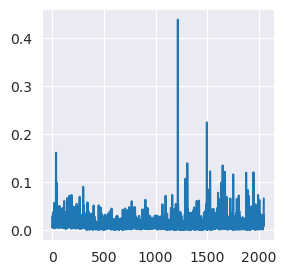

Concept vector 0, direction 35 activation:  0.766593982270327


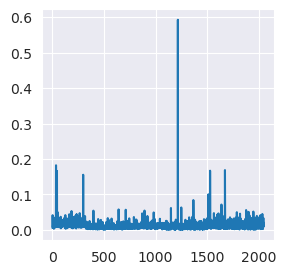

Concept vector 1, direction 35 activation:  0.651292056874263


In [31]:
for idx, cluster in enumerate(np.unique(clu_labs_rm_outliers)):
    if cluster == 100: 
        pass
    else:
        plt.plot(concept_vecs[idx])
        plt.show()
        print(f"Concept vector {round(cluster)}, direction {direction} activation: ", top_activations[clu_labs_rm_outliers==cluster].mean(0)[direction])

[[1.         0.79992168]
 [0.79992168 1.        ]]


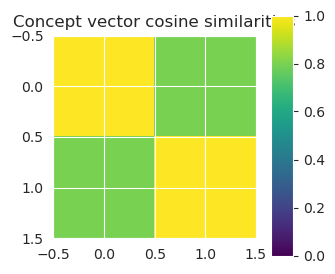

In [32]:
print(concepts_sim)
ax = plt.subplot()
im = ax.imshow(concepts_sim, cmap='viridis', interpolation='nearest', vmin=0, vmax=1) 
plt.title(f"Concept vector cosine similarities")
plt.subplots_adjust(right=0.8)
cbar_ax = plt.axes([0.85, 0.1, 0.075, 0.8])
plt.colorbar(mappable=(im), cax=cbar_ax)
plt.show()

Projection of top activating direction images on concept vectors vs vanilla direction

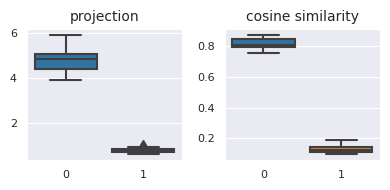

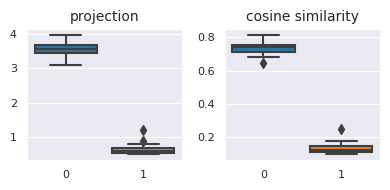

In [33]:
for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        concept_vec = top_activations[clu_labs_rm_outliers==cluster].mean(0)/np.linalg.norm(top_activations[clu_labs_rm_outliers==cluster].mean(0))
        cluster_vecs = top_activations[clu_labs_rm_outliers==cluster]
        concept_dot = [np.dot(concept_vec, cluster_vecs[i]) for i in range(cluster_vecs.shape[0])]
        #print("\nconcept_dot - projections along concept: ",concept_dot)
        concept_sim = [concept_dot[i]/np.linalg.norm(cluster_vecs[i]) for i in range(cluster_vecs.shape[0])]
        #print("\nconcept_sim - cosine similarity with concept: ",concept_sim)

        direction_dot = cluster_vecs[:,direction]
        #print("\ndirection_dot - projections along direction: ", direction_dot)
        direction_sim = [direction_dot[i]/np.linalg.norm(cluster_vecs[i]) for i in range(cluster_vecs.shape[0])]
        #print("\ndirection_sim - cosine similarity with direction: ",direction_sim)
        fig, axs = plt.subplots(1, 2, figsize=(2*2, 2 * 1))
        axs[0].set_title(f"projection", fontsize=10)
        axs[0].tick_params(axis='both', which='major', labelsize=8)
        axs[0].tick_params(axis='both', which='minor', labelsize=8)
        sns.boxplot((concept_dot, direction_dot),ax = axs[0])
        axs[1].set_title(f"cosine similarity", fontsize=10)
        axs[1].tick_params(axis='both', which='major', labelsize=8)
        axs[1].tick_params(axis='both', which='minor', labelsize=8)
        sns.boxplot((concept_sim, direction_sim),ax = axs[1])
        plt.tight_layout()


### Maximally projecting images along concept directions

Find images with largest projection along concept direction. This is effecttively finding the maximally activating images for these directions. 

Check these directions are clean, monosemantic regions. 

In [34]:
concepts_ims_dot = np.empty([len(conv_maps_avg),len(concept_vecs)])
concepts_ims_sim = np.empty([len(conv_maps_avg),len(concept_vecs)])
for i in range(len(conv_maps_avg)):
    for concept_id in range(len(concept_vecs)):
        concepts_ims_dot[i,concept_id] = np.dot(conv_maps_avg[i], concept_vecs[concept_id])
        concepts_ims_sim[i,concept_id] = concepts_ims_dot[i,concept_id]/(np.linalg.norm(conv_maps_avg[i])*np.linalg.norm(conv_maps_avg[concept_id]))


In [35]:
top_projs = []
for concept in range(len(concepts_ims_dot[0,])):
    top_projs.append(concepts_ims_dot[:,concept].argsort()[-top:][::-1])

In [36]:
# top_projs

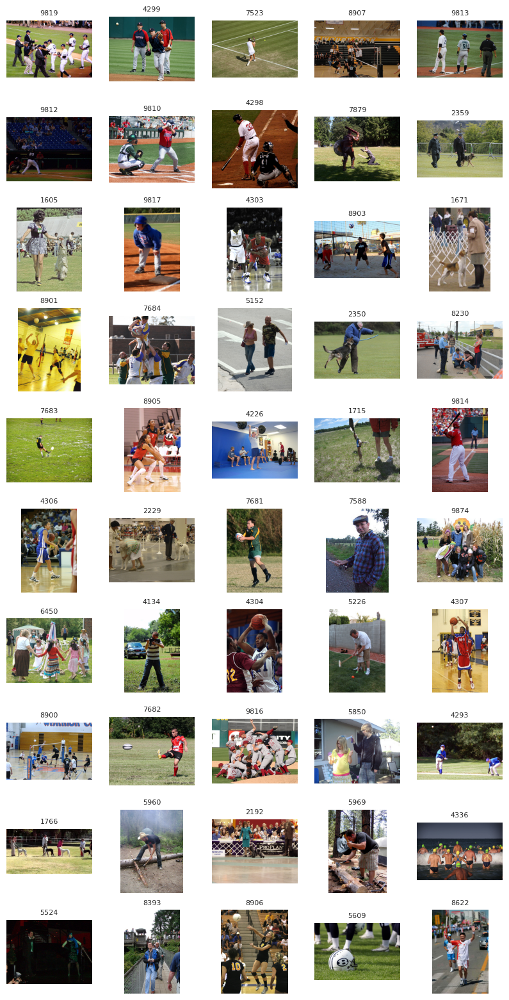

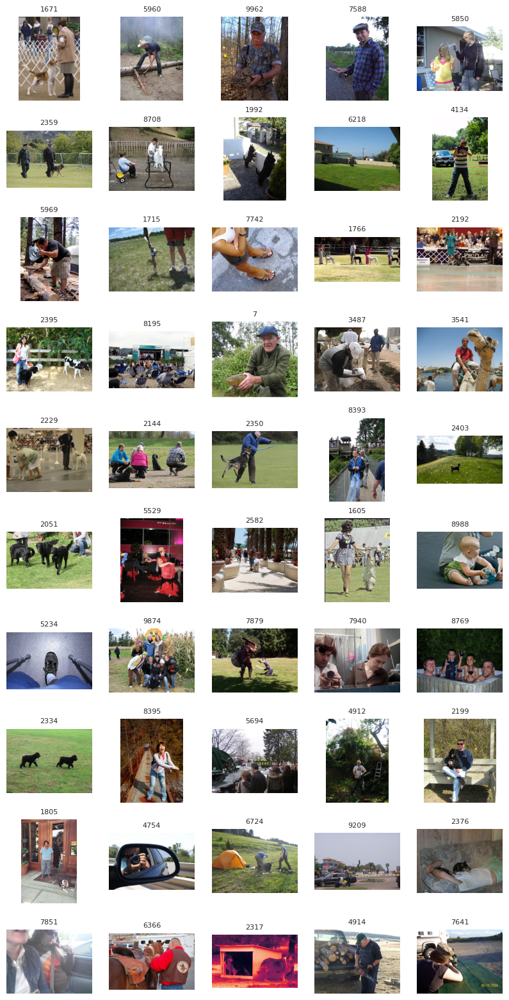

In [37]:
for concept in range(len(concept_vecs)):
    fig, ax = plt.subplots(math.ceil(top//5), 5, figsize = (10,20))
    ax = ax.flatten()
    for idx, im_id in enumerate(top_projs[concept]):# enumerate(concepts_dot[:,concept].argsort()[-top:][::-1]):
        im = Image.open(paths[im_id])
        ax[idx].imshow(im)
        ax[idx].set_title(f"{im_id}", size = 8)
        ax[idx].axis('off')

In [38]:
#Compared to the original top activating images for the direction:
# print(top_ims)
# top_ims = utilities.get_activations(activations_avg = activations, direction = direction).argsort()[-top:][::-1] 
# for i in range(50):
#         im = Image.open(paths[top_ims[i]])
#         plt.imshow(im)
#         plt.axis('off')
#         plt.show()

## Human in the loop

Generate 5 images for each cluster for qualitative assessment of concepts. 

Cluster 0 samples: 
6


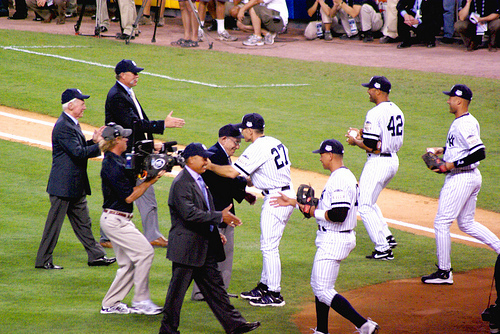

12


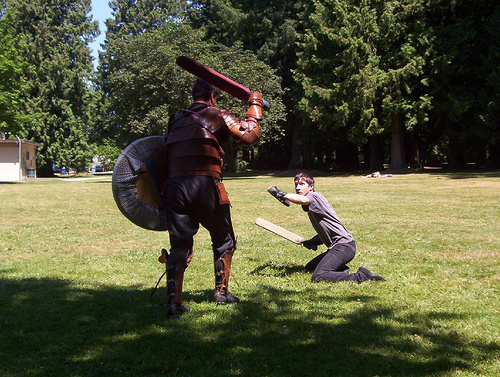

6


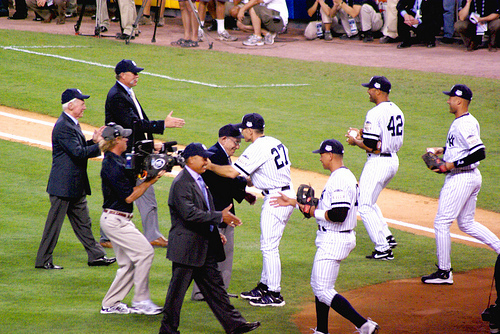

0


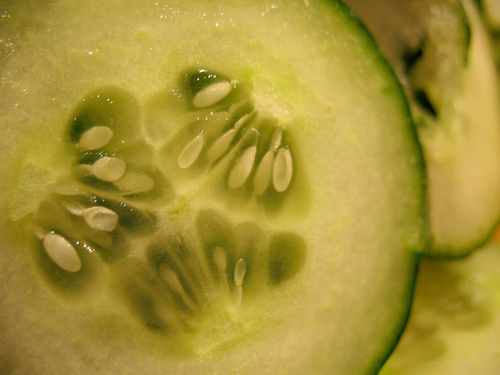

4


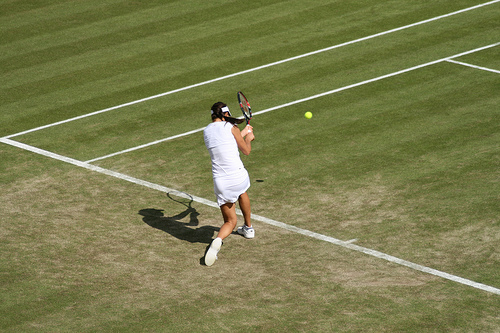

Cluster 1 samples: 
28


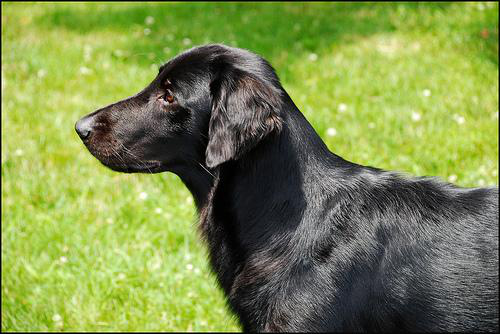

27


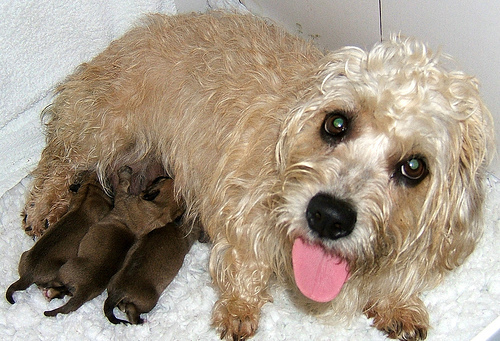

24


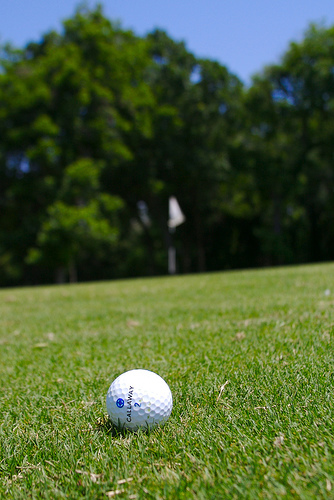

21


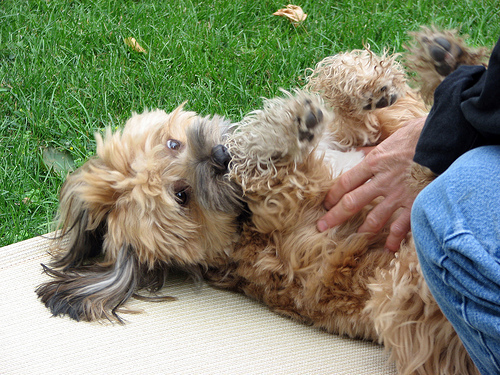

27


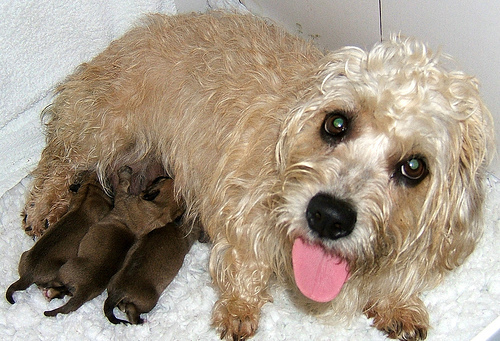

In [39]:
# count observations in each cluster as we randomly select 5 of these images with a random seed
# count is a list of the number of observations to choose from in each cluster
random.seed(0)
count = []
for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        count_cl = 0
        for i in range(len(clu_labs_rm_outliers)):
            if clu_labs_rm_outliers[i] == cluster:
                count_cl += 1       
        count.append(count_cl) 
        
# print 5 images of each concept, save manually and use in study
for idx, cluster in enumerate(np.unique(clu_labs_rm_outliers)):
    if cluster == 100: 
        pass
    else:
        print(f"Cluster {round(cluster)} samples: ")
        for samples_ in range(5):
            if idx == 0: 
                rand_cl = random.randint(0,count[idx]) 
            else:
                rand_cl = random.randint(sum(count[:idx]), sum(count[:idx+1]))
            print(rand_cl)
            im_id = top_ims[clu_labs_rm_outliers_order][rand_cl-1]
            im = Image.open(paths[im_id])
            im.show()

Generate 5 top projecting images for each concept for qualitative assessment of concepts. 

Concept 0 samples: 
22


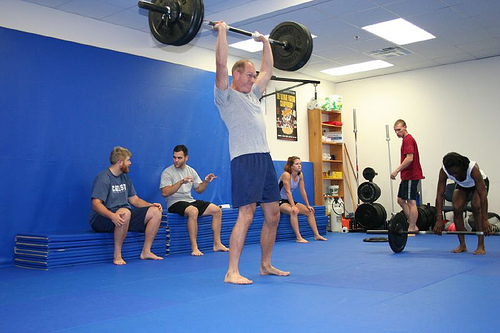

37


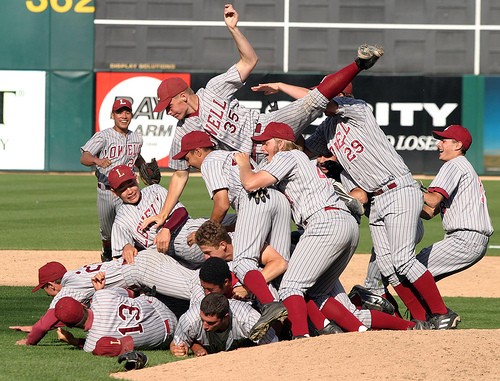

13


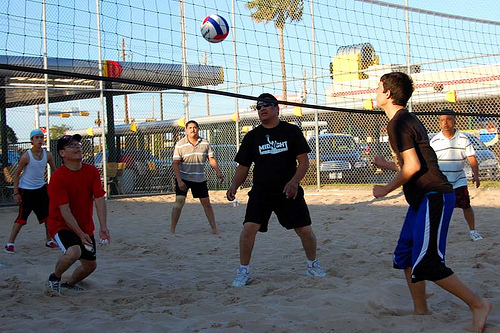

32


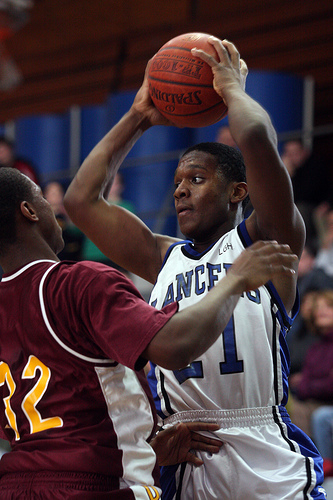

8


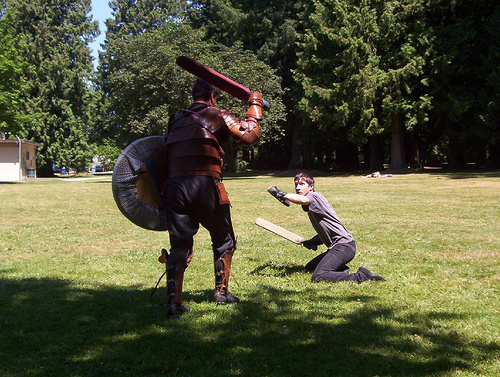

Concept 1 samples: 
18


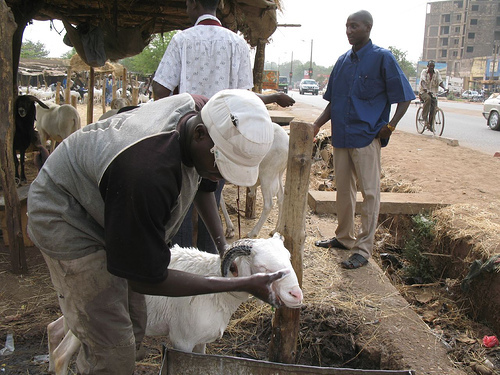

8


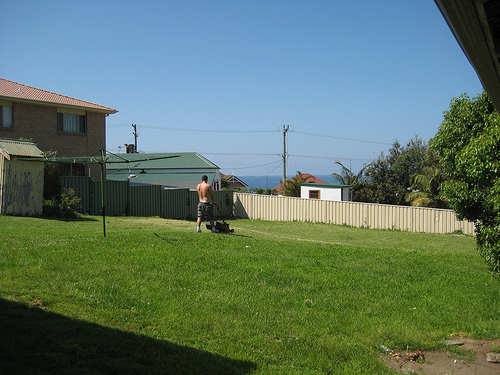

48


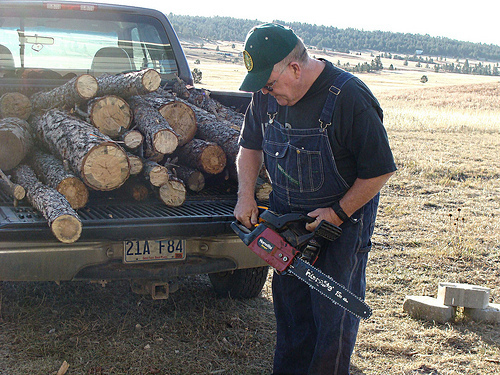

6


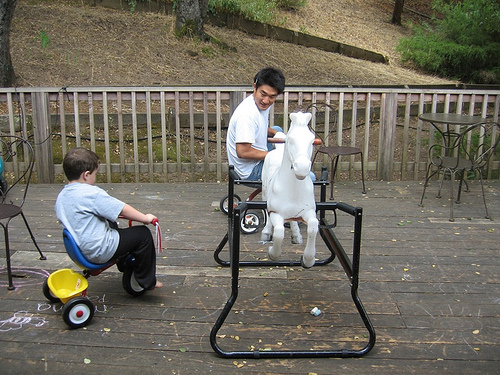

39


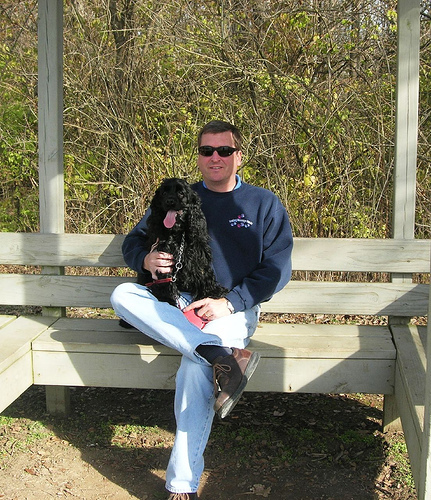

In [40]:
for concept in range(len(top_projs)):
    print(f"Concept {round(concept)} samples: ")
    for samples_ in range(5):
        rand_im = random.randint(0,top) 
        print(rand_im)
        im_id = top_projs[concept][rand_im]
        im = Image.open(paths[im_id])
        im.show()
#top_projs[concept]

Cluster 0 samples: 
12


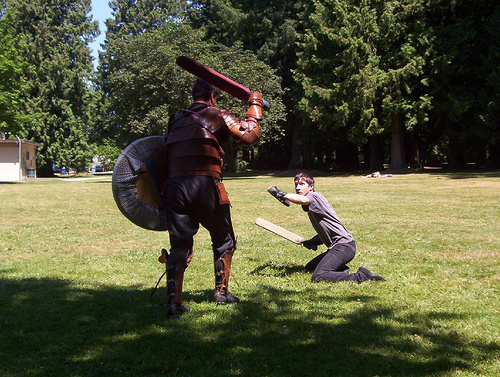

4


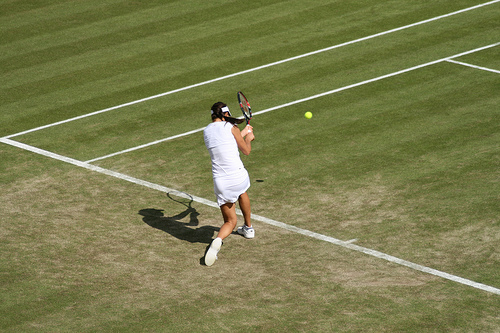

8


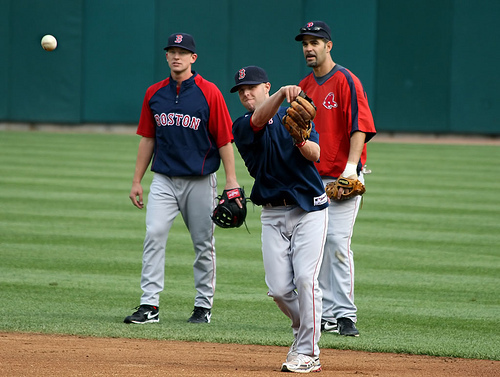

11


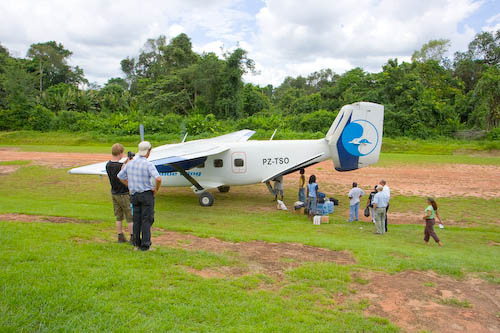

12


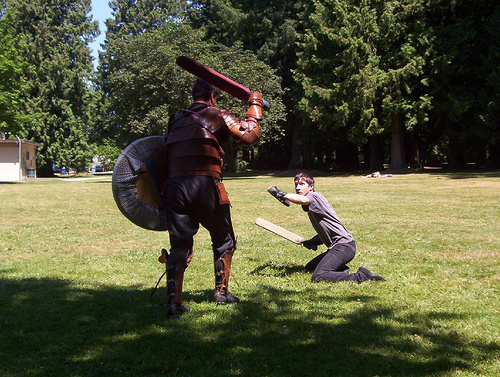

Cluster 1 samples: 
31


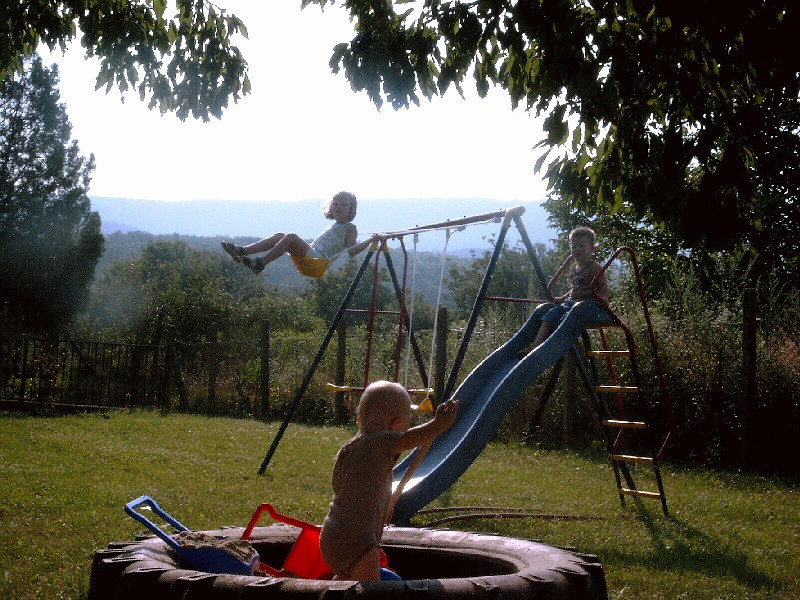

16


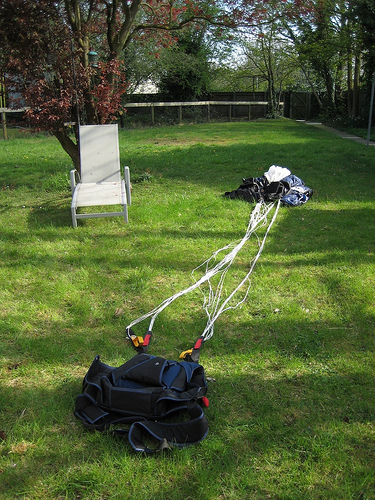

21


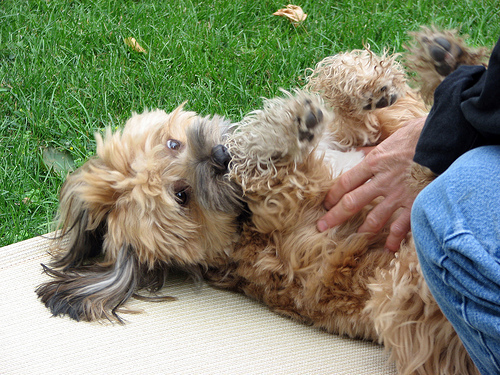

15


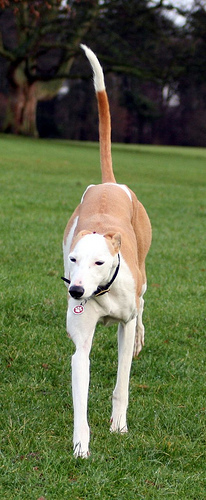

14


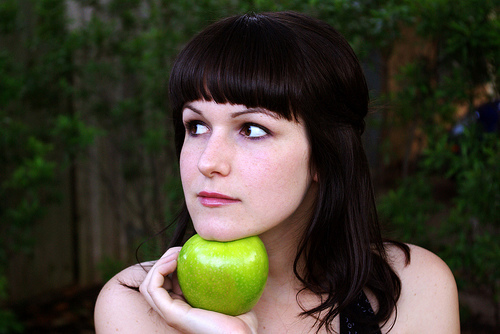

In [41]:
# print 5 images from each cluster, save manually and use in study
for idx, cluster in enumerate(np.unique(clu_labs_rm_outliers)):
    if cluster == 100: 
        pass
    else:
        print(f"Cluster {round(cluster)} samples: ")
        for samples_ in range(5):
            if idx == 0: 
                rand_cl = random.randint(0,count[idx]) 
            else:
                rand_cl = random.randint(sum(count[:idx]), sum(count[:idx+1]))
            print(rand_cl)
            im_id = top_ims[clu_labs_rm_outliers_order][rand_cl-1]
            im = Image.open(paths[im_id])
            im.show()

## Feature visualisation

In [ ]:
# !pip uninstall scripts-inceptionv3
#!pip install -e .

In [ ]:
torch.hub.load('pytorch/vision:v0.9.0', 'inception_v3', pretrained=True).state_dict()

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = torch.hub.load('pytorch/vision:v0.9.0', 'inception_v3', pretrained=True)
model.to(device).eval()
# tried... 
# import inceptionv3
# imp.reload(inceptionv3) 
# print("model")
# inceptionv3.InceptionV3.Inception5h(pretrained=True)
# torch.hub.load('pytorch/vision:v0.9.0', 'inception_v3', pretrained=True, progress=True).state_dict()
# model = inceptionv3.InceptionV3.Inception5h(pretrained=True)

In [ ]:
from lucent.modelzoo.util import get_model_layers

In [ ]:
get_model_layers(model)

In [ ]:
layer='Mixed_7b'

direction objective

In [ ]:
batch_param_f = lambda: param.image(128, batch=6, decorrelate=True)
obj = objectives.channel(layer, direction)
_ = render.render_vis(model, obj, batch_param_f, show_inline=True, verbose=True)

In [ ]:
batch_param_f = lambda: param.image(128, batch=6, decorrelate=True)
obj = objectives.channel(layer, direction) - 0.2 * objectives.diversity(layer)
_ = render.render_vis(model, obj, batch_param_f, show_inline=True, verbose=True)

cluster direction objectives

In [ ]:
concept_vecs

In [ ]:
i = 0
for concept in range(len(concept_vecs)):
    batch_param_f = lambda: param.image(128, batch=6, decorrelate=True)
    obj = objectives.direction(layer, torch.tensor(concept_vecs[i]).to(device)) # round(cluster) 
    _ = render.render_vis(model, obj, batch_param_f, show_inline=True, verbose=True)
    i+=1

In [ ]:
i = 0
for concept in range(len(concept_vecs)):
    batch_param_f = lambda: param.image(128, batch=6, decorrelate=True)
    obj = objectives.direction(layer, torch.tensor(concept_vecs[i]).to(device)) # round(cluster) 
    _ = render.render_vis(model, obj, batch_param_f, transforms=[transform.jitter(2)], show_inline=True, verbose=True)
    i+=1

In [ ]:
i = 0
for concept in range(len(concept_vecs)):
    batch_param_f = lambda: param.image(128, batch=6, decorrelate=True)
    obj = objectives.direction(layer, torch.tensor(concept_vecs[i]).to(device)) - 0.2 * objectives.diversity(layer)
    _ = render.render_vis(model, obj, batch_param_f, transforms=[transform.jitter(2)], show_inline=True, verbose=True)
    i+=1

### Random analysis

In [ ]:
#test
# clu_labs
# print(clu_lab_order)
# clu_labs_rm_outliers
# clu_labs_rm_outliers_order = sorted(range(len(clu_labs_rm_outliers)), key=lambda k: clu_labs_rm_outliers[k])
# print(clu_labs_rm_outliers[clu_labs_rm_outliers_order])
# print(clu_labs_rm_outliers_order)
# clu_labs_rm_outliers
# clu_labs_rm_outliers
# clu_labs_rm_outliers[clu_labs_rm_outliers != 100]

In [ ]:
print("clusterer.n_clusters_: ", clusterer.n_clusters_)
print("clusterer.n_leaves_: ", clusterer.n_leaves_)
print("clusterer.children_: ", clusterer.children_)
print("clusterer.distances_: ", clusterer.distances_)

## Save images

In [ ]:
# create and empty folders
if not os.path.exists(f'{SAVEFOLD}concept_ims_direction_{direction}/'):
    os.mkdir(f'{SAVEFOLD}concept_ims_direction_{direction}/')
if not os.path.exists(f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims/'):
    os.mkdir(f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims')
        
folder = f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims/'
for filename in os.listdir(folder):
    file_path = os.path.join(folder, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print('Failed to delete %s. Reason: %s' % (file_path, e))

In [ ]:
# create and empty folders for top images
if not os.path.exists(f'{SAVEFOLD}concept_ims_direction_{direction}/'):
    os.mkdir(f'{SAVEFOLD}concept_ims_direction_{direction}/')
if not os.path.exists(f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims/'):
    os.mkdir(f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims')
        
folder = f'{SAVEFOLD}concept_ims_direction_{direction}/top_ims/'
for filename in os.listdir(folder):
    file_path = os.path.join(folder, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            shutil.rmtree(file_path)
    except Exception as e:
        print('Failed to delete %s. Reason: %s' % (file_path, e))
        
# create and empty folders for concepts and ransom
concepts = [f'cluster_{round(i)}' for i in np.unique(clu_labs_rm_outliers)] + [f'random_{round(i)}' for i in np.unique(clu_labs_rm_outliers)]
for concept in concepts:
    if not os.path.exists(f'{SAVEFOLD}concept_ims_direction_{direction}/{concept}/'):
        os.mkdir(f'{SAVEFOLD}concept_ims_direction_{direction}/{concept}/')
    folder = f'{SAVEFOLD}concept_ims_direction_{direction}/{concept}/'
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
        except Exception as e:
            print('Failed to delete %s. Reason: %s' % (file_path, e))

In [ ]:
# populate folders
for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        top_ims[clu_labs_rm_outliers==cluster]

for idx, im_id in enumerate(top_ims[clu_lab_order]):
    im = Image.open(paths[im_id])
    im.save(f"{SAVEFOLD}concept_ims_direction_{direction}/top_ims/{os.path.basename(os.path.normpath(paths[im_id]))}")

for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        for idx, im_id in enumerate(top_ims[clu_labs_rm_outliers==cluster]): 
            im = Image.open(paths[im_id])
            im.save(f"{SAVEFOLD}concept_ims_direction_{direction}/cluster_{round(cluster)}/{os.path.basename(os.path.normpath(paths[im_id]))}")
    

In [ ]:
# populate folders of random images to test concepts against
for cluster in np.unique(clu_labs_rm_outliers):
    if cluster == 100: 
        pass
    else:
        for idx, im_id in enumerate(top_ims[clu_labs_rm_outliers==cluster]): 
            rand = random.randint(0, len(paths))
            im = Image.open(paths[rand])
            im.save(f"{SAVEFOLD}concept_ims_direction_{direction}/random_{round(cluster)}/{os.path.basename(os.path.normpath(paths[rand]))}")
